# Folder navigation

In [1]:
import os
import re
from pathlib import Path

In [2]:
def build_file_list_from_path(path=Path('..')):
    empty_list = []
    
    # Build a list of every file directory in the given folder
    for root, dirs, files in os.walk(path.resolve()):
        print(root)
        # Filter out directories that contain unimportant or hidden files
        dirs[:] = [d for d in dirs if not d[0] == '.']
        dirs[:] = [d for d in dirs if not d[0] == '_']
        
        # use files and dirs
        for directory in dirs:
            print(f"\n\nSaving files in: {root}/{directory}")
            directory = Path(f"{root}/{directory}")
            
            for file_var in os.listdir(directory):
                root_dir = Path(f"{root}")
                print(f"Saving: {Path(root/directory/file_var)}")
                
                empty_list.append(f"{Path(root/directory/file_var)}")
    
    return empty_list

In [3]:
list_of_files = build_file_list_from_path()

C:\Users\drpar\PycharmProjects\civilpy


Saving files in: C:\Users\drpar\PycharmProjects\civilpy/civilpy
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\CLI.py
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\construction
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\environmental
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\general
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\geotechnical
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\state
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\structural
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\transportation
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\water_resources
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\webpages
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\__init__.py
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\__pycache__


Saving files in: C:\Users\drpar\PycharmProjects\civilpy/res
Saving: C:\Users\drpar\PycharmProject

In [4]:
from pprint import pprint

for file in list_of_files:
    pprint(str(file))

'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\CLI.py'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\construction'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\environmental'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\general'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\geotechnical'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\state'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\structural'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\transportation'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\water_resources'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\webpages'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\__init__.py'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\__pycache__'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\ODOT_sample_plans.pdf'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\ODOT_sample_plans_modified.pdf'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\

### Filter list of files for certain file types

In [5]:
photos = [ fi for fi in list_of_files if re.search("(svg|heif|bmp|tiff|webp|jpeg|png|jpg)$", str(fi), re.IGNORECASE)]

In [6]:
photos

['C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_1.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_2.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_3.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_4.jpg',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_5.jpg',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_6.jpg']

### Map Out Photos

In [7]:
from PIL import Image
from PIL.Image import Exif
from PIL.ExifTags import TAGS, GPSTAGS

def get_exif(file_name) -> Exif:
    image: Image.Image = Image.open(file_name)
    return image.getexif()


def get_geo(exif):
    for key, value in TAGS.items():
        if value == "GPSInfo":
            break
    gps_info = exif.get_ifd(key)
    return {
        GPSTAGS.get(key, key): value
        for key, value in gps_info.items()
    }

In [8]:
photo_dict = {}

for photo in photos:
    exif = get_exif(photo)
    geo = get_geo(exif)
    photo_dict[photo] = geo

In [9]:
gps_info = photo_dict['C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_5.jpg']

In [10]:
#Get Latitude and Longitude
lat=gps_info['GPSLatitude']
long=gps_info['GPSLongitude']
#Convert to degrees
lat=float(lat[0]+(lat[1]/60)+(lat[2]/(3600*100)))
long=float(long[0]+(long[1]/60)+(long[2]/(3600*100)))
#Negative if LatitudeRef:S or LongitudeRef:W
if gps_info['GPSLatitudeRef']=='S':
    lat=-lat
if gps_info['GPSLongitudeRef']=='W':
    long=-long

In [11]:
import folium
# Create map
m=folium.Map(location=[lat,long],zoom_start=5) 
# Add Circle Marker
folium.CircleMarker(location=[lat,long],fill=True, color='red',fill_color='red').add_to(m)
# View Map
m

### Display the image

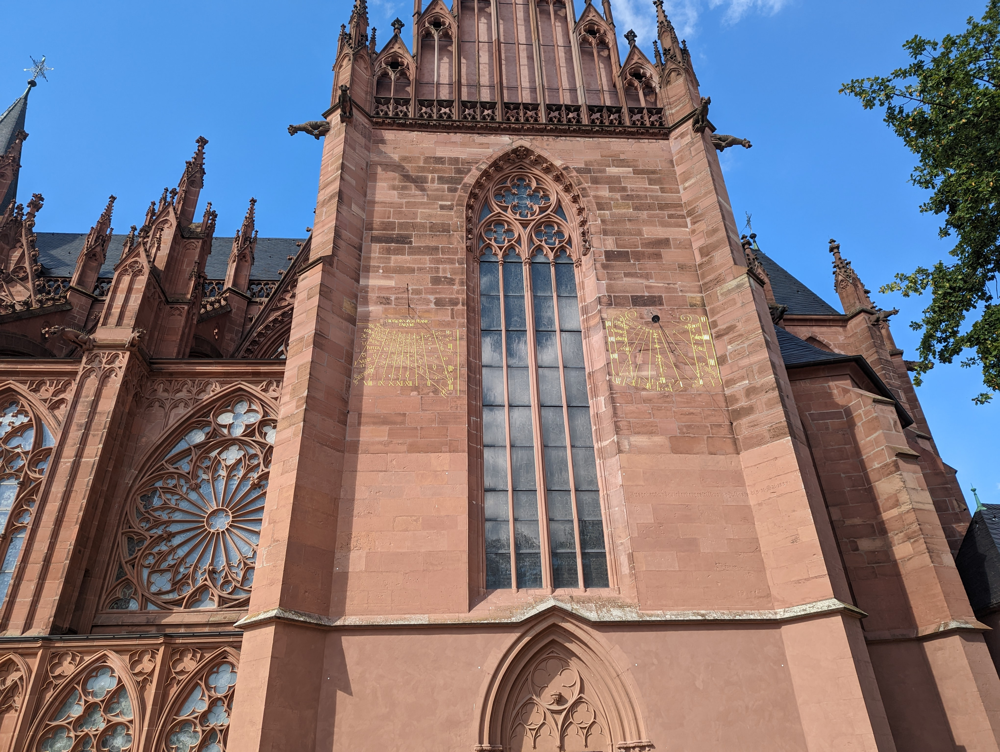

In [12]:
img = Image.open(photos[4])
img

## import civilpy functions

In [13]:
from civilpy.state.ohio.dot import Project

NameError: name 'GIS' is not defined

In [ ]:
full_data_url = "https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/33846832?f=pjsonpage.content"

page = requests.get(full_data_url)
data_json = json.loads(page.content)

In [ ]:
def get_project_data_from_tims(pid='112664'):
    url = f"https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/query?where=PID_NBR%3D{pid}&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=&having=&returnIdsOnly=true&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&historicMoment=&returnDistinctValues=false&resultOffset=&resultRecordCount=&queryByDistance=&returnExtentOnly=false&datumTransformation=&parameterValues=&rangeValues=&quantizationParameters=&featureEncoding=esriDefault&f=html"

    page = requests.get(url)
    url_base = 'https://gis.dot.state.oh.us'
    soup = BeautifulSoup(page.content, 'html5lib')

    all_page_links = soup.find_all('a')
    project_point_links = {}
    counter = 0

    for link in all_page_links:
        print(link.text)
        if link.text.isnumeric():
            counter += 1
            full_data_url = url_base + link.get('href') + '?f=pjson'
            print(f"Retrieving data from url at {full_data_url}\n")

            page = requests.get(full_data_url)
            data_json = json.loads(page.content)
            temp = data_json
            
            try:
                extracted_data = data_json['feature']['attributes']
            except:
                return data_json

            project_point_links[link.text] = extracted_data

        else:
            data_json = ''

    project_point_links['no_of_pts'] = counter

    return project_point_links

In [ ]:
test = get_project_data_from_tims('112664')
test

In [ ]:
single_dict = test[list(test.keys())[0]]

In [ ]:
single_dict